<a href="https://colab.research.google.com/github/Saadman53/Thesis-Human-Activity-Recognition/blob/Defense/4_DLF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import numpy as np
from sklearn.cross_decomposition import CCA
from sklearn.decomposition import PCA
import scipy.io as sio
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
from statsmodels.multivariate.cancorr import CanCorr
import pickle

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.nn.functional as F
from torch.utils import data

from torch.utils.data import DataLoader, TensorDataset
from torch import Tensor
import torch.optim as optim

import torchvision
import torchvision.transforms as transforms



import random
from sklearn.metrics import confusion_matrix, recall_score, precision_score
from sklearn.model_selection import train_test_split


import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import classification_report


from torch.utils.data import DataLoader, ConcatDataset
# from torchvision import transforms
from sklearn.model_selection  import StratifiedKFold

import torch.optim.lr_scheduler as lr_scheduler

import scipy.io as sio
torch.autograd.set_detect_anomaly(True)


from functools import partial
from typing import Any, Optional

import torch
import torch.nn as nn





import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn
import math
import os
import time

from numba.core.cgutils import if_likely
#from os.path import exists
import os.path 

import cv2
import sklearn
import scipy.io as sio
from numba import jit
from math import factorial, log
from sklearn.neighbors import KDTree
from scipy.signal import periodogram, welch
from astropy.timeseries import LombScargle
from scipy.io import loadmat
import re
import itertools


import imageio
from skimage import feature


from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

%matplotlib notebook

!pip install imageio
import imageio

from IPython.display import Image, display,HTML
import tempfile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [8]:
activity = {
    0: "Right High Wave",
    1: "Left High Wave",
    2: "Right Horizontal Wave",
    3: "Left Horizontal Wave",
    4: "Hammer with Right Hand",
    5: "Grasp with Right Hand",
    6: "Draw X with Right Hand",
    7: "Draw X with Left Hand",
    8: "Draw a Circle with The Right Hand",
    9: "Draw a Circle with The Left Hand",
    10: "Right Foot Kick Forward",
    11: "Left Foot Kick Forward",
    12: "Right Foot Kick Side",
    13: "Left Foot Kick Side",
    14: "Clap",
    15: "Bend Down",
    16: "Wave up and Down",
    17: "Sur Place",
    18: "Left Body Turning Movement",
    19: "Right Body Turning Movement",
    20: "Left Lateral Movement",
    21: "Right Lateral Movement",
}
def spectral_entropy(x, sf=100, method='fft', nperseg=None, normalize=False,axis=-1):
  
    x = np.asarray(x)
    #sf = np.array(sf, dtype=np.float64)
    # Compute and normalize power spectrum
    if method == 'fft':
        _, psd = periodogram(x, sf, axis=axis)
    elif method == 'welch':
        _, psd = welch(x, sf, nperseg=nperseg, axis=axis)
    psd_norm = psd / psd.sum(axis=axis, keepdims=True)
    se = -(psd_norm * np.log2(psd_norm)).sum(axis=axis)
    if normalize:
        se /= np.log2(psd_norm.shape[axis])
    return se
def statf(df,c):
    col = 'a_'+c
    col1 = 'g_'+c
    # acc
    mean_a = df[col].mean()
    var_a = df[col].var()
    std_a = df[col].std()
    mx_a = df[col].max()
    mn_a = df[col].min()
    rng_a = mx_a-mn_a
    #mode = df[col].mode()
    #n_z = ((df[col][:-1] * df[col][1:]) < 0).sum()
    
    #gyro
    mean_g = df[col1].mean()
    var_g = df[col1].var()
    std_g = df[col1].std()
    mx_g = df[col1].max()
    mn_g = df[col1].min()
    rng_g = mx_g-mn_g
    
    f_a=abs(np.fft.fft(df[col]))
    f_g=abs(np.fft.fft(df[col1]))
    num=df.shape[0]
    
    #fs=1./diff(t)
    
    freq = [i / num for i in list(range(num))]
    
    spectrum_a = f_a.real*f_a.real+f_a.imag*f_a.imag
    dc_comp_a = spectrum_a[0]
    spectrum_a = np.multiply(spectrum_a,spectrum_a)  # get the sectrum square
    spec_energy_a = spectrum_a.sum()/num
    
    spectrum_g = f_g.real*f_g.real+f_g.imag*f_g.imag
    dc_comp_g = spectrum_g[0]
    spectrum_g = np.multiply(spectrum_g,spectrum_g)  # get the sectrum square
    spec_energy_g = spectrum_g.sum()/num
    
    # spectral entropy
    
#     df['ts_shifted'] = df['ts'].shift(1)
#     freq1=df['ts'] - df['ts_shifted']
#     freq1 = freq1.dropna(axis = 0, how = 'all')

    
    tim = df['ts'][df.shape[0]-1] - df['ts'][0]
    freq1 = df.shape[0]/tim
    mean_freq = np.mean(freq1)
    #mean_freq = 1/np.mean(freq1)
    spec_entropy_a = spectral_entropy(df[col], mean_freq, method='fft', nperseg=None, normalize=False,axis=-1)
    spec_entropy_g = spectral_entropy(df[col1], mean_freq, method='fft', nperseg=None, normalize=False,axis=-1)
    
    # poer spectral density using LombScargle Periodogram
    
    frequency_a, power_a = LombScargle(df['ts'], df[col]).autopower()

    max_psd_a = np.max(power_a)
    min_psd_a = np.min(power_a)
    min_max_psd_a = min_psd_a/max_psd_a
    
    max_xas_a = np.sqrt(max_psd_a)
    min_xas_a = np.sqrt(min_psd_a)
    min_max_xas_a = min_xas_a/max_xas_a
    
    frequency_g, power_g = LombScargle(df['ts'], df[col1]).autopower()

    max_psd_g = np.max(power_g)
    min_psd_g = np.min(power_g)
    min_max_psd_g = min_psd_g/max_psd_g
    
    max_xas_g = np.sqrt(max_psd_g)
    min_xas_g = np.sqrt(min_psd_g)
    min_max_xas_g = min_xas_g/max_xas_g
    return np.array([mean_a ,var_a ,std_a ,mx_a ,mn_a ,rng_a ,dc_comp_a ,spec_energy_a, spec_entropy_a,
                     max_psd_a ,min_psd_a ,min_max_psd_a ,max_xas_a ,min_xas_a ,min_max_xas_a ,
                    mean_g ,var_g ,std_g ,mx_g ,mn_g ,rng_g ,dc_comp_g ,spec_energy_g, spec_entropy_g,
                     max_psd_g ,min_psd_g ,min_max_psd_g ,max_xas_g ,min_xas_g ,min_max_xas_g ])
    
def sensor_feature_extraction(sen_matfile, selected_features):
  #Sen = sio.loadmat(path+filename)['sensor']          # (10,0)
  Sen = sen_matfile['sensor']
  sen_pos = []
  for sen_no in range(10):
    sen = Sen[sen_no][0]                              # (no_of_rows , 7)

    df = pd.DataFrame(sen, columns = ['a_x','a_y','a_z','g_x','g_y','g_z','ts'])

    #----------------------------------------------------------------------------------------------
    x = statf(df,'x')
    y = statf(df,'y')
    z = statf(df,'z')
    df['a_m'] =  np.sqrt(df['a_x']*df['a_x']+df['a_y']*df['a_y']+df['a_z']*df['a_z'])
    df['g_m'] =  np.sqrt(df['g_x']*df['g_x']+df['g_y']*df['g_y']+df['g_z']*df['g_z'])
    m = statf(df,'m')
    
    sen_feat_i = np.concatenate((x, y, z, m), axis = 0)  
    #print(f"shape of individual sensor features = {sen_feat_i.shape}")

    if(sen_no==0):
        sen_feat = sen_feat_i
    else:
        sen_feat = np.concatenate([sen_feat,sen_feat_i],axis=0)

    #------------------------------------------------------------------------------------------------
  sen_feat[np.isnan(sen_feat)] = 0
  #print(f"shape of 10 sensor features = {sen_feat.shape}")
  #--------------------------------------------------------------------------------------------------
  sen_names  = ['0_','1_','2_','3_','4_','5_','6_','7_','8_','9_']

  col = ['mean','var','std','max','min','range','dc_comp','spec_energy','spec_entropy','max_psd','min_psd','min_max_psd','max_xas','min_xas','min_max_xas']
  axis = ['_a_x','_g_x','_a_y','_g_y','_a_z','_g_z','_a_m','_g_m']

  col_name = []

  for s in sen_names:
      for x in axis:
          for (c) in (col):
              col_name.append(s+c+x)
  #print(f"number of overall features:{len(col_name)}")

  ser = pd.Series(sen_feat, index = col_name);

  # return only the selected features
  feature_list = ser[ser.index.isin(selected_features)]

  return feature_list

def masked(img):
  x = np.logical_and((img>=70), (img<=90)).astype(int)
  return x

#sobel 
skernelx = np.array([[1,2,1],[0,0,0],[-1,-2,-1]])
skernely = np.array([[-1,0,1],[-2,0,2],[-1,0,1]])

def sobel_filtered_x(d):
  #d = masked(d)
  d = d.astype('float32')
  im = cv2.resize(d, dsize=(227,227))
  
  imx = cv2.filter2D(im, -1, skernelx)
  
  return imx

def get_dmm(d,ch='s'):   # param: a 
  start = time.time()
  dep, ht, wd = d.shape
  F = np.zeros((227,227))
  for i in range(dep):
    im = np.array(d[i])
    im = cv2.resize(im, dsize=(227,227))
    im = masked(im)
    im = sobel_filtered_x(im)
    if(i>0):
      F = np.add( F, np.absolute( np.subtract( im, front_pre ) ) )
    front_pre = im
  return F

def depth_map_preprocess(d_mat):
  d = d_mat['depth']
  frame, h, w = d.shape
  if (frame < 100) :
    d = np.concatenate(( d, d[:(100-frame)] ), axis=0)
  res = []
  for k in range(0,100,4):
    res.append(np.array(d[k][50:350,100:400]))
  res = np.array(res)
  dmm = get_dmm(res,'s')
  return dmm

def alexnet_feature_extraction(X):
  'Instantiate the model'
  alexnet = torchvision.models.alexnet(pretrained=True)
  alexnet.classifier = torch.nn.Sequential(*list(alexnet.classifier.children())[:-4]) #keeping only the first fc layer

  'Necessary transformations for Alexnet'
  data_transforms = transforms.Compose([
      transforms.ToPILImage(),
      transforms.Resize((256),interpolation=transforms.InterpolationMode.BILINEAR),
      transforms.CenterCrop(224),
      transforms.ToTensor(),
      transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
  ])
  t = torch.tensor(X, dtype = torch.float32).reshape((1,227,227))
  t = t.expand(3,*t.shape[1:])
  return alexnet(torch.unsqueeze(data_transforms(t),0)).ravel()

def get_softmax(pred):
  return torch.log_softmax(pred, dim = 1)
def get_label(pred):
  _, y_pred = torch.max(pred, dim = 1)
  return y_pred.item()

class DNN1(nn.Module):
    def __init__(self,input_size,output_size):
        super(DNN1,self).__init__()
        self.hidden1 = nn.Linear(input_size,2048)
        self.hidden2 = nn.Linear(2048,1024)
        self.hidden3 = nn.Linear(1024,256)
        self.hidden4 = nn.Linear(256,64)
        self.output = nn.Linear(64,output_size)
        self.softmax = F.softmax
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(p=0.25)
        self.batchnorm1 = nn.BatchNorm1d(2048)
        self.batchnorm2 = nn.BatchNorm1d(1024)
        self.batchnorm3 = nn.BatchNorm1d(256)
        self.batchnorm4 = nn.BatchNorm1d(64)
    
    def forward(self,x):
        out = self.hidden1(x)
        out = self.batchnorm1(out)
        out = self.relu(out)
        
        out = self.hidden2(out)
        out = self.batchnorm2(out)
        out = self.relu(out)
        out = self.dropout(out)

        out = self.hidden3(out)
        out = self.batchnorm3(out)
        out = self.relu(out)
        out = self.dropout(out)

        out = self.hidden4(out)
        out = self.batchnorm4(out)
        out = self.relu(out)
        out = self.dropout(out)

        out = self.output(out)
        return out
class DNN2(nn.Module):
    def __init__(self,input_size,output_size):
        super(DNN2,self).__init__()
        self.hidden1 = nn.Linear(input_size,256)
        self.hidden2 = nn.Linear(256,128)
        self.hidden3 = nn.Linear(128,64)
        self.output = nn.Linear(64,output_size)
        self.softmax = F.softmax
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(p=0.25)
        self.batchnorm1 = nn.BatchNorm1d(256)
        self.batchnorm2 = nn.BatchNorm1d(128)
        self.batchnorm3 = nn.BatchNorm1d(64)
    
    def forward(self,x):
        out = self.hidden1(x)
        out = self.batchnorm1(out)
        out = self.relu(out)
        
        out = self.hidden2(out)
        out = self.batchnorm2(out)
        out = self.relu(out)
        out = self.dropout(out)

        out = self.hidden3(out)
        out = self.batchnorm3(out)
        out = self.relu(out)
        out = self.dropout(out)

        out = self.output(out)
        return out
def display_activity(img, label,filename):
  with tempfile.NamedTemporaryFile(suffix='.gif') as f:
    imageio.mimsave(f.name, img['depth'], fps=24)
    gif = Image(filename=f.name)
    display(HTML(f"<h1>{activity[label]}</h1>"))
    display(gif)

In [10]:
def Decision_Level_Fusion(img, sens):
  start_time = time.time()
  acc_features = sio.loadmat("drive/My Drive/Dataset/Final Dataset/Train Test Set/acc_feature_list_ecfs_efsmi.mat")['ecfs']
  acc_features = [x.replace(" ","") for x in acc_features]
  gyro_features = sio.loadmat("drive/My Drive/Dataset/Final Dataset/Train Test Set/gyro_feature_list_ecfs_efsmi.mat")['ecfs']
  gyro_features = [x.replace(" ","") for x in gyro_features]
  acc_scaler = pickle.load(open("drive/My Drive/Dataset/Final Dataset/Models/Standard Scaler/ACC_scaler",'rb'))
  gyro_scaler = pickle.load(open("drive/My Drive/Dataset/Final Dataset/Models/Standard Scaler/GYRO_scaler",'rb'))
  sobel_scaler = pickle.load(open("drive/My Drive/Dataset/Final Dataset/Models/Standard Scaler/SOBEL_scaler",'rb'))
  s_data = sensor_feature_extraction(sens, [*acc_features,*gyro_features])
  acc_data = torch.Tensor(acc_scaler.transform(s_data.loc[acc_features].values.reshape(1,-1)))
  gyro_data = torch.Tensor(gyro_scaler.transform(s_data.loc[gyro_features].values.reshape(1,-1)))
  img= torch.Tensor(sobel_scaler.transform(alexnet_feature_extraction(depth_map_preprocess(img)).detach().numpy().reshape((1,-1))))

  acc_dnn = DNN2(acc_data.shape[1], 22)
  acc_dnn.load_state_dict(torch.load("drive/My Drive/Dataset/Final Dataset/Models/ECFS/acc_dnn_ecfs_1675853933.059038_.pt"))
  acc_dnn.eval()
  gyro_dnn = DNN2(gyro_data.shape[1], 22)
  gyro_dnn.load_state_dict(torch.load("drive/My Drive/Dataset/Final Dataset/Models/ECFS/gyro_dnn_ecfs_1675853257.852747_.pt"))
  gyro_dnn.eval()
  sobel_dnn = DNN1(img.shape[1],22)
  sobel_dnn.load_state_dict(torch.load("drive/My Drive/Dataset/Final Dataset/Models/DMM/DMM_Sobel_DNN_1675764751.571087_.pt"))
  sobel_dnn.eval()
  
  img_pred = get_softmax(sobel_dnn(img))
  acc_pred = get_softmax(acc_dnn(acc_data))
  gyro_pred = get_softmax(gyro_dnn(gyro_data))
  print(f"Accelerometer Model predicts this as \"{activity[get_label(acc_pred)]}\" activity.")
  print("------------------------------------------------------------------------------------")
  print(f"Image Model predicts this as \"{activity[get_label(img_pred)]}\" activity.")
  print("------------------------------------------------------------------------------------")
  print(f"Gyroscope Model predicts this as \"{activity[get_label(gyro_pred)]}\" activity.")
  print("------------------------------------------------------------------------------------")
  print(f"Decision Level Fusion predicts this as \"{activity[get_label(gyro_pred+img_pred+acc_pred)]}\" activity.")
  print("------------------------------------------------------------------------------------")
  end_time = time.time()
  print(f"Inference time: {end_time-start_time} second(s).")

In [11]:
filename = "cx_a1_t8.mat"
label = int(filename.split('_')[1][1:])-1
img = sio.loadmat("drive/My Drive/Dataset/Testing/Depth Test/"+filename)
sens = sio.loadmat("drive/My Drive/Dataset/Testing/Sensor Test/"+filename)

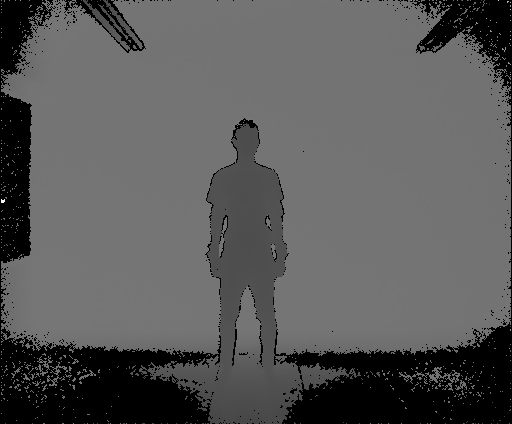

In [12]:
display_activity(img,label,filename)

In [13]:
Decision_Level_Fusion(img, sens)

Accelerometer Model predicts this as "Right High Wave" activity.
------------------------------------------------------------------------------------
Image Model predicts this as "Draw a Circle with The Right Hand" activity.
------------------------------------------------------------------------------------
Gyroscope Model predicts this as "Right High Wave" activity.
------------------------------------------------------------------------------------
Decision Level Fusion predicts this as "Right High Wave" activity.
------------------------------------------------------------------------------------
Inference time: 7.905451774597168 second(s).
